In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns



In [54]:
drugs_df = pd.read_csv('C:\\Users\\hites\\Downloads\\Compressed\\drugsComTrain_raw.csv')

In [55]:
drugs_df.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9,20-May-12,27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8,27-Apr-10,192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5,14-Dec-09,17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8,3-Nov-15,10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9,27-Nov-16,37


In [56]:
drugs_df = drugs_df.drop(['uniqueID'],axis=1)

In [157]:
drugs_df.head()

,drugName,condition,review,rating,date,usefulCount,Sentiment
0,Valsartan,Left Ventricular Dysfunction,effect combination bystolic 5 mg fish oil,9,20-May-12,27,Positive
1,Guanfacine,ADHD,son halfway fourth week intuniv concerned week...,8,27-Apr-10,192,Positive
2,Lybrel,Birth Control,oral contraceptive 21 pill cycle happy light p...,5,14-Dec-09,17,Neutral
3,Ortho Evra,Birth Control,time birth control glad patch 8 months decreas...,8,3-Nov-15,10,Positive
4,Buprenorphine / naloxone,Opiate Dependence,suboxone completely turned life healthier exce...,9,27-Nov-16,37,Positive


In [155]:
# Number of null values in each column
drugs_df.isnull().sum()

drugName       0
condition      0
review         0
rating         0
date           0
usefulCount    0
Sentiment      0
dtype: int64

In [156]:
# Unique values in each column
drugs_df.nunique()

drugName         3431
condition         884
review         111686
rating             10
date             3579
usefulCount       389
Sentiment           3
dtype: int64

In [64]:
drugs_df.describe()

,rating,usefulCount
count,160398.000000,160398.000000
mean,6.995923,28.097613
std,3.272303,36.457876
min,1.000000,0.000000
25%,5.000000,6.000000
50%,8.000000,16.000000
75%,10.000000,36.000000
max,10.000000,1291.000000


In [65]:
# Drop Condition null rows from the dataset
drugs_df.dropna(subset=['condition'], how='all', inplace=True)

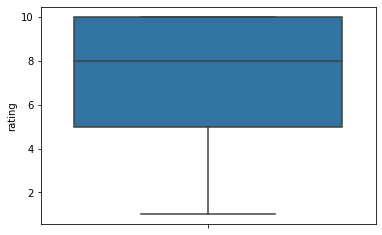

In [66]:
# Rating column boxplot

sns.boxplot(drugs_df['rating'],orient='vertical')

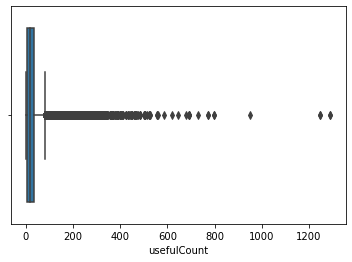

In [67]:
# usefulcount column boxplot
sns.boxplot(drugs_df['usefulCount'],orient='horizontal')

In [ ]:
# Bucketing the ratings in positive, negative and neutral into a new column Sentiment

drugs_df.loc[drugs_df['rating'] <= 4, 'Sentiment'] = 'Negative'
drugs_df.loc[drugs_df['rating'] >= 7, 'Sentiment'] = 'Positive'
drugs_df.loc[(drugs_df['rating'] > 4) & (drugs_df['rating'] < 7), 'Sentiment'] = 'Neutral'

In [68]:
# Drug name along with its rating and usefulCount

pd.set_option('display.max_rows', None)
drugs_df.groupby(['drugName','rating'])['usefulCount'].count()

drugName                                                                                          rating
A + D Cracked Skin Relief                                                                         10           1
A / B Otic                                                                                        10           1
Abacavir / dolutegravir / lamivudine                                                              1            1
                                                                                                  3            2
                                                                                                  4            3
                                                                                                  5            6
                                                                                                  7            4
                                                                                                  9     

In [240]:
# Drugs count based on the sentiment for each drug
pd.set_option('display.max_rows', None)
drugs_df.groupby(['drugName','Sentiment'])['usefulCount'].count().sort_values(ascending=False)

drugName                                                                                          Sentiment
Levonorgestrel                                                                                    Positive     2544
Etonogestrel                                                                                      Positive     1581
Phentermine                                                                                       Positive     1377
Ethinyl estradiol / norethindrone                                                                 Positive     1302
Etonogestrel                                                                                      Negative     1292
Ethinyl estradiol / norethindrone                                                                 Negative     1139
Ethinyl estradiol / norgestimate                                                                  Positive     1015
Sertraline                                                                      

In [133]:
# Updating the stopwords list by adding dataset specific stop words into the stop words list already in the sklearn 

from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS as esw
stopWords = ["got",
"did",
"took",
"just",
"taking",
"feel",
"doctor",
"felt",
"went",
"having",
"ago",
"used",
"going",
"using",
"use",
"amp",
"think",
"does",
"things",
"overall",
"similar",
"instructions",
"039"
"alas",
"form",
"said",
"began",
"im"
] + list(esw) 

In [82]:
X=drugs_df['review'].values

In [83]:
y=drugs_df['rating'].values

In [84]:
training_labels = set(y)
print(training_labels)

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10}


In [85]:
# Reviews rating with their count for each rating how many reviews are present
training_category_dist = np.unique(y, return_counts = True)
print(training_category_dist)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10], dtype=int64), array([21504,  6879,  6465,  4980,  7959,  6301,  9395, 18791, 27379,
       50745], dtype=int64))


In [134]:
# Removing patterns, strings, punctuation to clean the text review data 

drugs_df['review_clean']=drugs_df['review'].str.lower().str.replace("&#039;", "").str.replace("11&quot;","").str.replace("&quot;","").str.replace("&rsquo;","").str.replace("&amp;","").str.replace("&gt;","").str.replace("â˜º","").str.replace("\r\n","").str.replace("\r\r\n\r\r\n","").str.replace(r'[^\w\d\s]',' ').str.replace(r'\s+',' ')

In [135]:
drugs_df['review_clean']

0                 effect combination bystolic 5 mg fish oil
1         son halfway fourth week intuniv concerned week...
2         oral contraceptive 21 pill cycle happy light p...
3         time birth control im glad patch 8 months decr...
4         suboxone completely turned life healthier im e...
5         2nd day 5mg started work rock hard erections e...
6         pulled cummed bit plan b 26 hours later pregna...
7         abilify changed life hope zoloft clonidine sta...
8         ve problems keppera constant shaking arms legs...
9         pill years changed rx chateal effective really...
10        medication weeks started 25mg working way 100m...
11        taken anti depressants years improvement moder...
12        crohns resection 30 years remission recently b...
13        little bit lingering cough cold giving trouble...
14        started nexplanon 2 months minimal contracepti...
15        saxenda july 2016 severe nausea month 2 6 dosa...
16        drug worked cleared uti matter

In [136]:
# Remove stop words from the review data
drugs_df['review_clean'] = drugs_df['review_clean'].apply(lambda x: ' '.join(word for word in x.split() if word not in stopWords))

In [137]:
# Vectorize the data 

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

#  unigram and bigram term frequency vectorizer, set minimum document frequency to 5
gram12_count_vectorizer = CountVectorizer(encoding='latin-1', ngram_range=(2,2), min_df=3)

#  unigram tfidf vectorizer, set minimum document frequency to 5
unigram_tfidf_vectorizer = TfidfVectorizer(encoding='latin-1', use_idf=True, min_df=5)

In [138]:
X_fit = gram12_count_vectorizer.fit(X)
X_transform = X_fit.transform(X)
X_train_vec = gram12_count_vectorizer.fit_transform(X)

# check the content of a document vector
print(X_train_vec.shape)
print(X_train_vec[0].toarray())

# check the size of the constructed vocabulary
print(len(gram12_count_vectorizer.vocabulary_))

# print out the first 10 items in the vocabulary
print(list(gram12_count_vectorizer.vocabulary_.items())[:50])
# check word index in vocabulary
print(gram12_count_vectorizer.vocabulary_)

(160398, 322785)
[[0 0 0 ... 0 0 0]]
322785
[('effect combination', 89715), ('combination bystolic', 51389), ('bystolic mg', 41940), ('fish oil', 107748), ('fourth week', 110596), ('week intuniv', 304949), ('week started', 305416), ('started highest', 261352), ('highest dose', 130843), ('dose days', 81825), ('days hardly', 67984), ('hardly bed', 124032), ('slept nearly', 254395), ('nearly hours', 192315), ('hours drive', 134838), ('drive home', 84777), ('home school', 131658), ('monday morning', 184342), ('stick days', 263758), ('days school', 68593), ('school getting', 244858), ('getting morning', 115239), ('morning days', 188511), ('days problem', 68470), ('problem free', 224114), ('emotional good', 93401), ('good thing', 118547), ('behavior better', 31236), ('better tried', 33586), ('tried different', 290961), ('different medications', 76265), ('medications far', 176181), ('far effective', 102815), ('oral contraceptive', 202794), ('21 pill', 5287), ('pill cycle', 213685), ('cycle ha

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [139]:
# Vocabulary of words

vocab = list(gram12_count_vectorizer.vocabulary_.keys())

In [140]:
vocab

['effect combination',
 'combination bystolic',
 'bystolic mg',
 'fish oil',
 'fourth week',
 'week intuniv',
 'week started',
 'started highest',
 'highest dose',
 'dose days',
 'days hardly',
 'hardly bed',
 'slept nearly',
 'nearly hours',
 'hours drive',
 'drive home',
 'home school',
 'monday morning',
 'stick days',
 'days school',
 'school getting',
 'getting morning',
 'morning days',
 'days problem',
 'problem free',
 'emotional good',
 'good thing',
 'behavior better',
 'better tried',
 'tried different',
 'different medications',
 'medications far',
 'far effective',
 'oral contraceptive',
 '21 pill',
 'pill cycle',
 'cycle happy',
 'light periods',
 'periods max',
 'max days',
 'days effects',
 'available switched',
 'pills ended',
 'ended started',
 'started lybrel',
 'immediately day',
 'day period',
 'period period',
 'period lasted',
 'lasted weeks',
 'weeks second',
 'second pack',
 'pack weeks',
 'weeks pack',
 'pack worse',
 'worse period',
 'weeks end',
 'end week',

In [141]:
word_freq = zip(X_fit.get_feature_names(),
    np.asarray(X_train_vec.sum(axis=0)).ravel())

In [142]:
new_woc = list(word_freq)

In [143]:
sum_words = X_transform.sum(axis=0)

In [144]:
# Bigrams from Count Vectorizer along with the frequency of their occurence

words_freq = [(word, sum_words[0, idx]) for word, idx in X_fit.vocabulary_.items()]
sorted(words_freq, key = lambda x: x[1], reverse=True)[:25]

[('birth control', 15159),
 ('weight gain', 8361),
 ('mood swings', 7720),
 ('sex drive', 5798),
 ('years old', 4171),
 ('blood pressure', 4019),
 ('panic attacks', 3756),
 ('dont know', 2959),
 ('year old', 2895),
 ('dry mouth', 2890),
 ('twice day', 2681),
 ('times day', 2620),
 ('weight loss', 2558),
 ('really bad', 2466),
 ('ive tried', 2390),
 ('highly recommend', 2310),
 ('10 years', 2290),
 ('gained weight', 2190),
 ('works great', 2087),
 ('depression anxiety', 2079),
 ('changed life', 2073),
 ('anxiety depression', 1830),
 ('couple days', 1791),
 ('10 days', 1760),
 ('gain weight', 1749)]

In [127]:
# Writing the output of bigrams with their occurences to the csv file
import csv
RESULTS = new_woc
resultFyle = open("output_new_woc.csv",'w')

# Write data to file
for r in RESULTS:
    resultFyle.write(r + "\n")
resultFyle.close()

In [246]:
# Negative reviews drugs along with their count

pd.set_option('display.max_rows', None)
drugs_df.groupby([drugs_df.loc[drugs_df['Sentiment'] == 'Negative','drugName']])['usefulCount'].count().sort_values(ascending=False)

drugName
Etonogestrel                                                                                        1292
Ethinyl estradiol / norethindrone                                                                   1139
Nexplanon                                                                                            870
Ethinyl estradiol / norgestimate                                                                     764
Levonorgestrel                                                                                       738
Miconazole                                                                                           726
Ethinyl estradiol / levonorgestrel                                                                   710
Medroxyprogesterone                                                                                  503
Depo-Provera                                                                                         472
Tioconazole                                   

In [262]:
drugs_df[drugs_df['condition'] == '4</span> users found this comment helpful.']['drugName'].count()

66

In [263]:
drugs_df[drugs_df['condition'] == '3</span> users found this comment helpful.']['drugName'].count()

84

In [264]:
drugs_df[drugs_df['condition'] == '2</span> users found this comment helpful.']['drugName'].count()

85

In [35]:
drugs_df['review_clean']

0                 effect combination bystolic 5 mg fish oil
1         son halfway fourth week intuniv concerned bega...
2         oral contraceptive 21 pill cycle happy light p...
3         time birth control im glad patch 8 months decr...
4         suboxone completely turned life healthier im e...
5         2nd day 5mg started work rock hard erections e...
6         pulled cummed bit plan b 26 hours later pregna...
7         abilify changed life hope zoloft clonidine sta...
8         ve problems keppera constant shaking arms legs...
9         pill years changed rx chateal effective really...
10        medication weeks started 25mg working way 100m...
11        taken anti depressants years improvement moder...
12        crohns resection 30 years remission recently b...
13        little bit lingering cough cold giving trouble...
14        started nexplanon 2 months minimal contracepti...
15        saxenda july 2016 severe nausea month 2 6 dosa...
16        drug worked cleared uti matter

In [183]:
# Positive reviews drugs count
pos_drugs = dict(drugs_df.loc[drugs_df['Sentiment'] == 'Positive','drugName'].value_counts())

In [228]:
# Drug Names for positive reviews
drug_pos = list(pos_drugs.keys())

In [229]:
# Count for drugs for positive reviews
pos_senti_count = list(pos_drugs.values())

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 <a list of 15 Text xticklabel objects>)

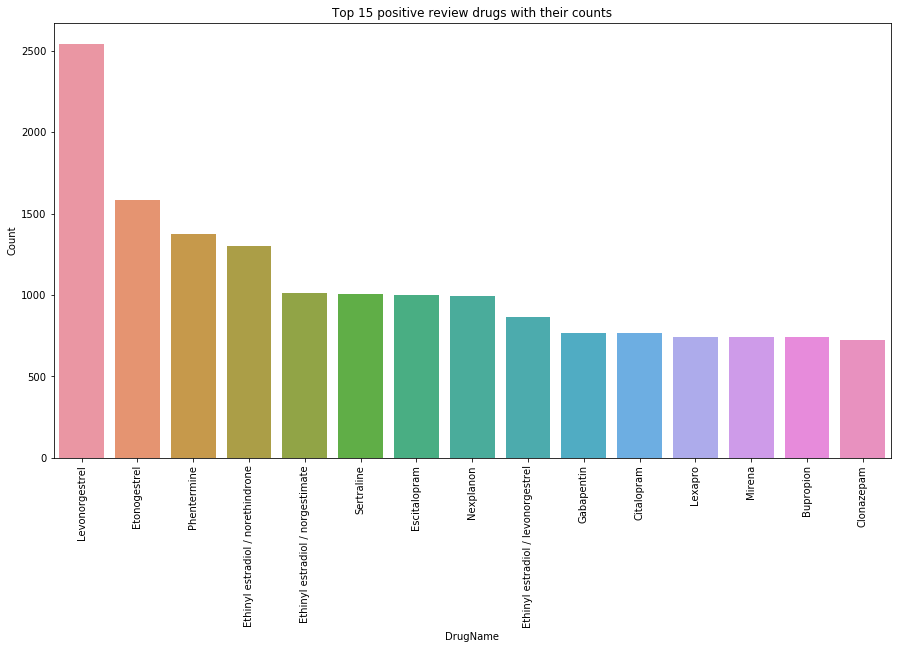

In [267]:
# Top 15 Drugs which have positive reviews along with their count

pos_se_drugs = sns.barplot(x = drug_pos[0:15], y = pos_senti_count[0:15])

plt.xlabel("DrugName")
plt.ylabel("Count")
plt.title("Top 15 positive review drugs with their counts")
plt.xticks(rotation=90)

In [268]:
# Negative reviews drugs count
neg_drugs = dict(drugs_df.loc[drugs_df['Sentiment'] == 'Negative','drugName'].value_counts())

In [269]:
# Drug Names for negative reviews
drug_neg = list(pos_drugs.keys())

In [270]:
# Count for drugs for positive reviews
neg_senti_count = list(neg_drugs.values())

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 <a list of 15 Text xticklabel objects>)

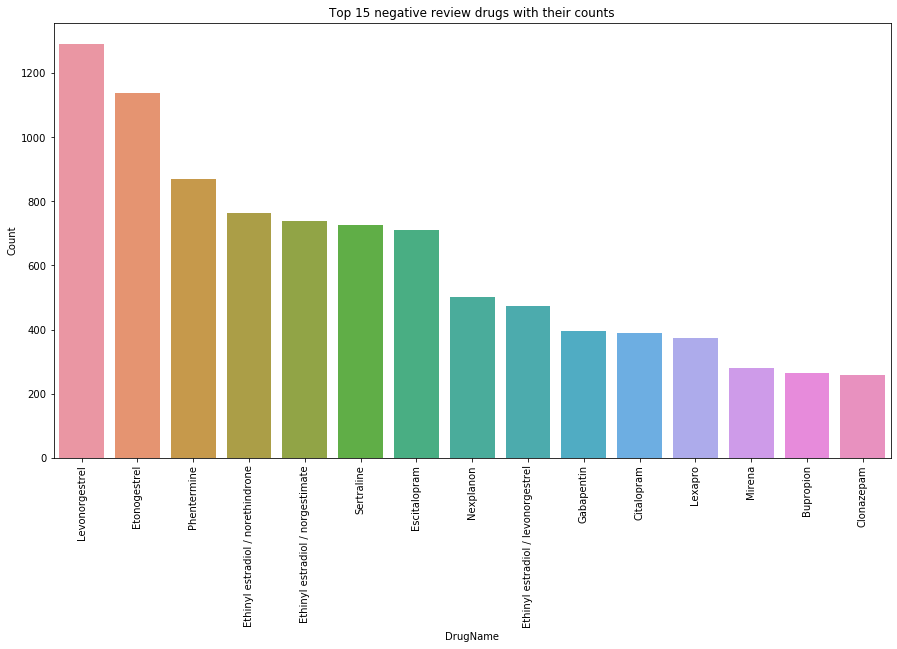

In [272]:
# Top 15 Drugs which have negative reviews along with their count

neg_se_drugs = sns.barplot(x = drug_neg[0:15], y = neg_senti_count[0:15])

plt.xlabel("DrugName")
plt.ylabel("Count")
plt.title("Top 15 negative review drugs with their counts")
plt.xticks(rotation=90)

In [275]:
con_top = dict(drugs_df['condition'].value_counts())

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 <a list of 15 Text xticklabel objects>)

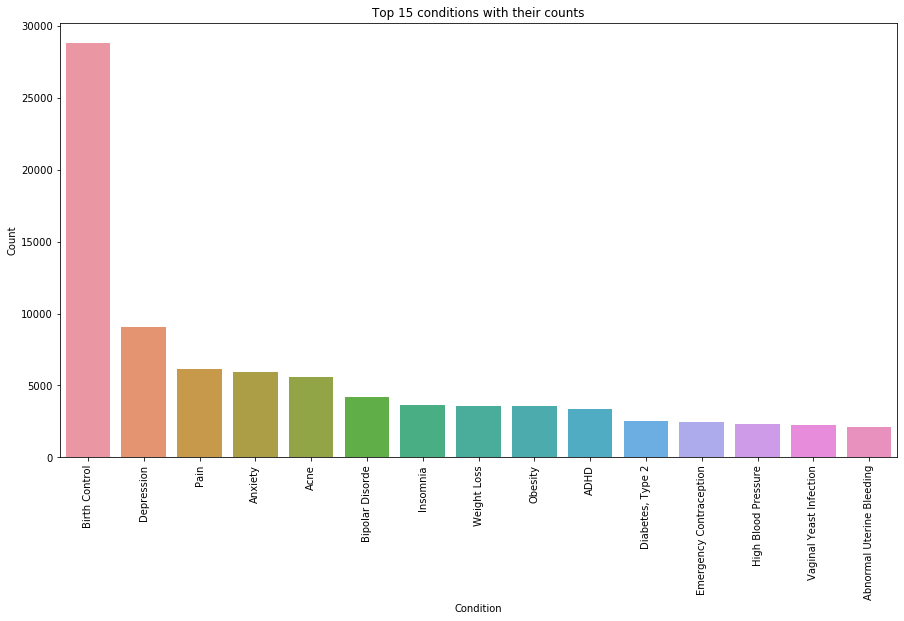

In [279]:
con_top_15 = sns.barplot(x = list(con_top.keys())[0:15], y = list(con_top.values())[0:15])

plt.xlabel("Condition")
plt.ylabel("Count")
plt.title("Top 15 conditions with their counts")
plt.xticks(rotation=90)